![Screenshot 2025-01-23 at 02.15.35](Screenshot%202025-01-23%20at%2002.15.35.png)


<div style="background-color:#; padding: 10px;">
    
<div class="alert alert-block alert-secondary" style="font-size:18px; font-family:verdana;">  
<b>Introduction:</b>

This study examines 439 Aljazeera English news articles  captured through RSS feeds, leveraging transformer-based NLP to analyze sentiment patterns in news coverage.<br>
    
Our dataset (title, pubDate, guid, link, description)
    </div>

In [78]:
# pip install ydata-profiling

In [79]:

# pip install ipywidgets

In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS

from wordcloud import WordCloud
import plotly.graph_objects as go
from ipywidgets import interact, Dropdown, IntSlider, ColorPicker
from IPython.display import display
import warnings
warnings.filterwarnings("ignore")
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from scipy.special import softmax
from ydata_profiling import ProfileReport
from transformers import pipeline

import torch

import ipywidgets as widgets

print("All imports successful!")

2025-01-23 00:06:56.628931: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


All imports successful!


In [3]:
data = pd.read_csv('aljazeera_news.csv')
data.head()

,title,pubDate,guid,link,description
0,"Far-right Oath Keepers, ex-Proud Boys leaders ...",21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/far-r...,https://www.aljazeera.com/news/2025/1/21/far-r...,"Stewart Rhodes and Enrique Tarrio, who receive..."
1,First raft of lawsuits target US birthright ci...,21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/first...,https://www.aljazeera.com/news/2025/1/21/first...,Donald Trump signs record 26 executive orders ...
2,Prince Harry court battle against Murdoch UK n...,21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/princ...,https://www.aljazeera.com/news/2025/1/21/princ...,British prince and former senior MP Tom Watson...
3,Israel’s top general resigns over ‘terrible’ O...,21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/israe...,https://www.aljazeera.com/news/2025/1/21/israe...,Herzi Halevi is the most senior Israeli figure...
4,"‘We will drill, baby, drill’: Why Trump wants ...",21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/drill...,https://www.aljazeera.com/news/2025/1/21/drill...,"For a second time, Donald Trump promises to pu..."


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 439 entries, 0 to 438
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   title        439 non-null    object
 1   pubDate      439 non-null    object
 2   guid         439 non-null    object
 3   link         439 non-null    object
 4   description  439 non-null    object
dtypes: object(5)
memory usage: 17.3+ KB


In [5]:
data.describe()

,title,pubDate,guid,link,description
count,439,439,439,439,439
unique,439,16,439,439,439
top,"Far-right Oath Keepers, ex-Proud Boys leaders ...",17 Jan 2025,https://www.aljazeera.com/news/2025/1/21/far-r...,https://www.aljazeera.com/news/2025/1/21/far-r...,"Stewart Rhodes and Enrique Tarrio, who receive..."
freq,1,40,1,1,1


In [6]:
df = data.copy()

In [7]:
profile = ProfileReport(df, title="Data Summary")
profile.to_file("report.html")  # Save as HTML
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

#### Let's categorize the news Articles 


In [8]:
import pandas as pd
from urllib.parse import urlparse

def extract_category(link):
    """
    Extracts the primary category from a given URL.
    """
    if not isinstance(link, str):
        return None

    parsed_url = urlparse(link)
    domain = parsed_url.netloc.lower()
    path = parsed_url.path.strip('/').split('/')

    category = None

    # Only process Al Jazeera URLs now
    if 'aljazeera.com' in domain:
        if len(path) >= 1:
            category = path[0]


    return category if category != "https:" else None

# Apply the function
df['category'] = df['guid'].apply(extract_category)

df

,title,pubDate,guid,link,description,category
0,"Far-right Oath Keepers, ex-Proud Boys leaders ...",21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/far-r...,https://www.aljazeera.com/news/2025/1/21/far-r...,"Stewart Rhodes and Enrique Tarrio, who receive...",news
1,First raft of lawsuits target US birthright ci...,21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/first...,https://www.aljazeera.com/news/2025/1/21/first...,Donald Trump signs record 26 executive orders ...,news
2,Prince Harry court battle against Murdoch UK n...,21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/princ...,https://www.aljazeera.com/news/2025/1/21/princ...,British prince and former senior MP Tom Watson...,news
3,Israel’s top general resigns over ‘terrible’ O...,21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/israe...,https://www.aljazeera.com/news/2025/1/21/israe...,Herzi Halevi is the most senior Israeli figure...,news
4,"‘We will drill, baby, drill’: Why Trump wants ...",21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/drill...,https://www.aljazeera.com/news/2025/1/21/drill...,"For a second time, Donald Trump promises to pu...",news
...,...,...,...,...,...,...
434,Ex-New York Mayor and Trump ally Rudy Giuliani...,6 Jan 2025,https://www.aljazeera.com/news/2025/1/6/ex-new...,https://www.aljazeera.com/news/2025/1/6/ex-new...,Giuliani has been under pressure to turn over ...,news
435,US reports first death linked to bird flu in L...,6 Jan 2025,https://www.aljazeera.com/news/2025/1/6/us-rep...,https://www.aljazeera.com/news/2025/1/6/us-rep...,The late patient had been hospitalised in Dece...,news
436,‘Packing up our things’: January 6 prisoners p...,6 Jan 2025,https://www.aljazeera.com/news/2025/1/6/packin...,https://www.aljazeera.com/news/2025/1/6/packin...,The fourth anniversary of the US Capitol riot ...,news
437,US envoy says Israeli army will withdraw compl...,6 Jan 2025,https://www.aljazeera.com/news/2025/1/6/us-env...,https://www.aljazeera.com/news/2025/1/6/us-env...,"As Israel pulls out of western sector, Amos Ho...",news


In [9]:
df.duplicated().sum()

0

In [10]:
# !pip install wordcloud matplotlib plotly
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import plotly.graph_objects as go
from ipywidgets import Dropdown, ColorPicker, IntSlider, interact

# Verified Kaggle font paths with fallback
KAGGLE_FONTS = [
    '/usr/share/fonts/truetype/dejavu/DejaVuSans.ttf',
    '/usr/share/fonts/truetype/liberation/LiberationSans-Regular.ttf',
    '/usr/share/fonts/truetype/freefont/FreeSans.ttf'
]

def interactive_wordcloud(data, title):
    text = ' '.join(data['title'].astype(str))

    # Widget controls
    colormap_dropdown = Dropdown(
        options=['twilight', 'viridis', 'plasma', 'magma', 'inferno'],
        value='twilight',
        description='Colormap:'
    )

    bg_color_picker = ColorPicker(
        value='black',
        description='Background:'
    )

    max_words_slider = IntSlider(
        min=100,
        max=1500,
        value=1000,
        description='Max Words:'
    )

    def update(colormap='twilight', bg_color='black', max_words=1000):
        wc = None  # Initialize variable
        
        # Try available fonts
        for font_path in KAGGLE_FONTS:
            try:
                wc = WordCloud(
                    font_path=font_path,
                    background_color=bg_color,
                    colormap=colormap,
                    max_words=max_words,
                    width=1200,
                    height=600
                ).generate(text)
                break
            except OSError:
                continue

        # Fallback if all fonts fail
        if wc is None:
            raise RuntimeError("""
            No working fonts found! Try:
            1. Add font to Kaggle Notebook (Settings -> Add Data)
            2. Update KAGGLE_FONTS list with correct path
            """)

        # Create plotly figure
        fig = go.Figure(go.Image(z=wc.to_array()))
        
        fig.update_layout(
            title=f'<b>{title}</b>',
            margin=dict(t=100, b=20),
            plot_bgcolor=bg_color,
            paper_bgcolor=bg_color
        )

        fig.show()

    interact(update,
             colormap=colormap_dropdown,
             bg_color=bg_color_picker,
             max_words=max_words_slider)

# Generate the dashboard
interactive_wordcloud(df, 'Interactive WordCloud - Title')

interactive(children=(Dropdown(description='Colormap:', options=('twilight', 'viridis', 'plasma', 'magma', 'in…

In [11]:
# Verified Kaggle font paths with fallback
KAGGLE_FONTS = [
    '/usr/share/fonts/truetype/dejavu/DejaVuSans.ttf',
    '/usr/share/fonts/truetype/liberation/LiberationSans-Regular.ttf',
    '/usr/share/fonts/truetype/freefont/FreeSans.ttf'
]

def interactive_wordcloud(data, description):
    text = ' '.join(data['description'].astype(str))

    # Widget controls
    colormap_dropdown = Dropdown(
        options=['twilight', 'viridis', 'plasma', 'magma', 'inferno'],
        value='twilight',
        description='Colormap:'
    )

    bg_color_picker = ColorPicker(
        value='black',
        description='Background:'
    )

    max_words_slider = IntSlider(
        min=100,
        max=1500,
        value=1000,
        description='Max Words:'
    )

    def update(colormap='twilight', bg_color='black', max_words=1000):
        wc = None  # Initialize variable
        
        # Try available fonts
        for font_path in KAGGLE_FONTS:
            try:
                wc = WordCloud(
                    font_path=font_path,
                    background_color=bg_color,
                    colormap=colormap,
                    max_words=max_words,
                    width=1200,
                    height=600
                ).generate(text)
                break
            except OSError:
                continue

        # Fallback if all fonts fail
        if wc is None:
            raise RuntimeError("""
            No working fonts found! Try:
            1. Add font to Kaggle Notebook (Settings -> Add Data)
            2. Update KAGGLE_FONTS list with correct path
            """)

        # Create plotly figure
        fig = go.Figure(go.Image(z=wc.to_array()))
        
        fig.update_layout(
            title=f'<b>{description}</b>',
            margin=dict(t=100, b=20),
            plot_bgcolor=bg_color,
            paper_bgcolor=bg_color
        )

        fig.show()

    interact(update,
             colormap=colormap_dropdown,
             bg_color=bg_color_picker,
             max_words=max_words_slider)

# Generate the dashboard
interactive_wordcloud(df, 'Interactive WordCloud - description')

interactive(children=(Dropdown(description='Colormap:', options=('twilight', 'viridis', 'plasma', 'magma', 'in…

In [90]:
#!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cpu

#### Defining Function to Analyze the Sentiments of News Description

In [12]:
# Check if CUDA is available and set the device accordingly
device = 0 if torch.cuda.is_available() else -1
print(f"Using device: {'GPU' if device == 0 else 'CPU'}")

# Load the tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("mrm8488/distilroberta-finetuned-financial-news-sentiment-analysis")
model = AutoModelForSequenceClassification.from_pretrained("mrm8488/distilroberta-finetuned-financial-news-sentiment-analysis")

# Initialize the sentiment analysis pipeline with the appropriate device
sentiment_pipeline = pipeline("sentiment-analysis", model=model, tokenizer=tokenizer, device=device)

# Define a function to perform sentiment analysis in batches
def analyze_sentiment_batch(descriptions, batch_size=32):
    sentiments = []
    for i in range(0, len(descriptions), batch_size):
        batch = descriptions[i:i+batch_size]
        try:
            batch_sentiments = sentiment_pipeline(batch)
            sentiments.extend(batch_sentiments)
        except Exception as e:
            print(f"Error processing batch {i // batch_size}: {e}")
            # Assign default sentiment for this batch
            sentiments.extend([{"label": "UNKNOWN", "score": 0.0} for _ in batch])
    return sentiments


# Handle missing or empty descriptions
df['description'] = df['description'].fillna("")

# Extract article descriptions from the DataFrame
article_descriptions = df["description"].tolist()

# Perform sentiment analysis
sentiments = analyze_sentiment_batch(article_descriptions, batch_size=2)

# Extract sentiment labels and scores
sentiment_labels = [sentiment["label"] for sentiment in sentiments]
sentiment_scores = [sentiment["score"] for sentiment in sentiments]

# Add sentiment labels and scores to the DataFrame
df["sentiment_label"] = sentiment_labels
df["sentiment_score"] = sentiment_scores

# Verify the DataFrame
print(df)

Using device: CPU


tokenizer_config.json:   0%|          | 0.00/333 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/933 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/328M [00:00<?, ?B/s]

                                                 title  ... sentiment_score
0    Far-right Oath Keepers, ex-Proud Boys leaders ...  ...        0.999811
1    First raft of lawsuits target US birthright ci...  ...        0.999564
2    Prince Harry court battle against Murdoch UK n...  ...        0.992750
3    Israel’s top general resigns over ‘terrible’ O...  ...        0.999654
4    ‘We will drill, baby, drill’: Why Trump wants ...  ...        0.961209
..                                                 ...  ...             ...
434  Ex-New York Mayor and Trump ally Rudy Giuliani...  ...        0.639413
435  US reports first death linked to bird flu in L...  ...        0.981461
436  ‘Packing up our things’: January 6 prisoners p...  ...        0.994784
437  US envoy says Israeli army will withdraw compl...  ...        0.998541
438  US Congress certifies Donald Trump’s victory i...  ...        0.990579

[439 rows x 8 columns]


In [13]:
output_dir = 'aljazeera-sentiment_labels'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

output_csv = os.path.join(output_dir, 'aljazeera_sentiment.csv')
df.to_csv(output_csv, index=False)
print(f"Sentiment analysis results saved to '{output_csv}'")

# Read the CSV back into a new DataFrame
df_loaded = pd.read_csv(output_csv)

# Display the first few rows
df_loaded.head()

Sentiment analysis results saved to 'aljazeera-sentiment_labels/aljazeera_sentiment.csv'


,title,pubDate,guid,link,description,category,sentiment_label,sentiment_score
0,"Far-right Oath Keepers, ex-Proud Boys leaders ...",21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/far-r...,https://www.aljazeera.com/news/2025/1/21/far-r...,"Stewart Rhodes and Enrique Tarrio, who receive...",news,neutral,0.999811
1,First raft of lawsuits target US birthright ci...,21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/first...,https://www.aljazeera.com/news/2025/1/21/first...,Donald Trump signs record 26 executive orders ...,news,neutral,0.999564
2,Prince Harry court battle against Murdoch UK n...,21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/princ...,https://www.aljazeera.com/news/2025/1/21/princ...,British prince and former senior MP Tom Watson...,news,neutral,0.992750
3,Israel’s top general resigns over ‘terrible’ O...,21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/israe...,https://www.aljazeera.com/news/2025/1/21/israe...,Herzi Halevi is the most senior Israeli figure...,news,neutral,0.999654
4,"‘We will drill, baby, drill’: Why Trump wants ...",21 Jan 2025,https://www.aljazeera.com/news/2025/1/21/drill...,https://www.aljazeera.com/news/2025/1/21/drill...,"For a second time, Donald Trump promises to pu...",news,negative,0.961209


In [14]:
# Display sample tweets for each sentiment
print("Positive Tweets:")
print(df_loaded.loc[df_loaded['sentiment_label'] == 'positive', 'description'].head(2).values)

print("\nNegative Tweets:")
print(df_loaded.loc[df_loaded['sentiment_label'] == 'negative', 'description'].head(2).values)

print("\nNeutral Tweets:")
print(df_loaded.loc[df_loaded['sentiment_label'] == 'neutral', 'description'].head(2).values)


Positive Tweets:
['Ten-time Melbourne champion fights back to win 4-6, 6-4, 6-3, 6-4 and set up a semifinal against Alexander Zverev.'
 'Political leaders across the world urge good relations with the new president, with some expressing concern.']

Negative Tweets:
['For a second time, Donald Trump promises to pull the US from a global agreement that most countries are party to.'
 'French superstar has silenced his doubters in recent weeks after struggling to settle in with the Spanish giants.']

Neutral Tweets:
['Stewart Rhodes and Enrique Tarrio, who received some of longest sentences for the US Capitol attack, freed from prison.'
 'Donald Trump signs record 26 executive orders on second term’s first day, including an effort to restrict citizenship.']


In [15]:
from plotly.subplots import make_subplots

# Create interactive controls
color_picker = widgets.ColorPicker(
    description='Highlight Color',
    value='#ff8680'  # Initial color matches your negative color
)

explosion_slider = widgets.FloatSlider(
    value=0.15,
    min=0,
    max=0.5,
    step=0.05,
    description='Explosion:'
)

# Prepare data
sentiment_counts = df_loaded['sentiment_label'].value_counts()
labels = ['Neutral', 'Positive', 'Negative']
colors = ['#ebde96', '#5ebd89', '#ff8680']

# Create 3D-like pie chart with dynamic effects
fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'domain'}]])
fig.add_trace(go.Pie(
    labels=labels,
    values=sentiment_counts,
    name="Sentiment",
    hole=0.3,
    marker=dict(colors=colors, line=dict(color='white', width=2)),
    pull=[0, 0, 0.15],
    rotation=1,
    textinfo='percent+label',
    hoverinfo='label+percent+value',
    textfont=dict(size=16, family="Araboto Bold 400.ttf"),
    hoverlabel=dict(
        bgcolor='white',
        font_size=14,
        font_family="Araboto Bold 400.ttf"
    )
))

# Add advanced layout features
fig.update_layout(
    title={
        'text': "<b>Sentiment Distribution</b>",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {
            'size': 24,
            'color': 'darkgray',
            'family': "Araboto Bold 400.ttf"
        }
    },
    height=600,
    width=800,
    annotations=[dict(
        text=f'Total: {sum(sentiment_counts)}',
        x=0.5,
        y=0.5,
        font_size=20,
        showarrow=False,
        font_color='gray'
    )],
    showlegend=False,
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    hovermode='closest',
    transition={'duration': 300}
)

# Add 3D-like effects
fig.update_traces(
    textposition='inside',
    insidetextorientation='radial',
    marker=dict(line=dict(width=2)),
    hoverlabel=dict(
        bordercolor='black',
        font=dict(color='black')
    )
)

# Create interactive update function
def update_chart(highlight_color=color_picker.value, explosion=explosion_slider.value):
    new_pull = [0, 0, explosion]
    new_colors = ['#ebde96', '#5ebd89', highlight_color]
    
    fig.data[0].update(
        pull=new_pull,
        marker=dict(colors=new_colors)
    )
    
    # Add rotation animation
    fig.update_layout(
        scene=dict(
            camera=dict(
                eye=dict(x=1.25, y=1.25, z=0.5)
            )
        )
    )
    
    fig.show()
    display(widgets.HBox([color_picker, explosion_slider]))

# Display interactive controls and initial chart
interact(update_chart, highlight_color=color_picker, explosion=explosion_slider)
print("Sentiment Value Counts:\n", df['sentiment_label'].value_counts())

interactive(children=(ColorPicker(value='#ff8680', description='Highlight Color'), FloatSlider(value=0.15, des…

Sentiment Value Counts:
 sentiment_label
neutral     323
negative     68
positive     48
Name: count, dtype: int64


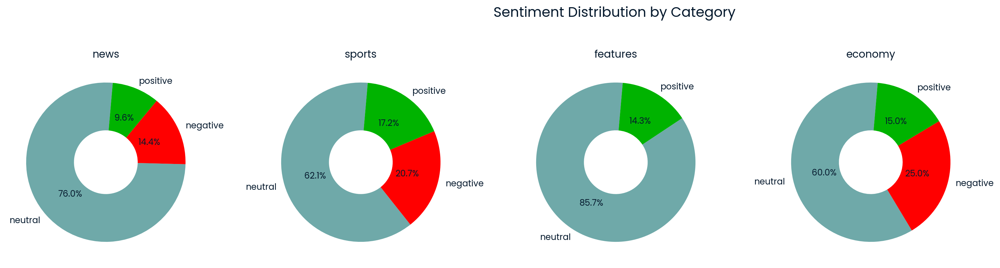

In [16]:
sentiment_labels = df_loaded['sentiment_label']
colors = {'positive': '#00b300', 'negative': '#ff0000', 'neutral': '#6fa9a9'}
categories = df_loaded['category'].unique()
num_rows = 2
num_cols = 5
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 8))
fig.suptitle('Sentiment Distribution by Category', fontsize=16)

axes = axes.flatten()
for i, category in enumerate(categories):
    data_category = df_loaded[df_loaded['category'] == category]['sentiment_label']
    sentiment_counts = data_category.value_counts()
    axes[i].pie(sentiment_counts, labels=sentiment_counts.index, colors=[colors[label] for label in sentiment_counts.index],
                autopct='%1.1f%%', startangle=85, wedgeprops=dict(width=0.6))
    axes[i].set_title(category)
for j in range(len(categories), num_rows * num_cols):
    fig.delaxes(axes[j])
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

In [17]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def generate_wordcloud(df, title):
    # Combine all text in the dataframe's 'Description' column
    text = ' '.join(desc for desc in df['description'].astype(str))
    
    # Create and generate word cloud
    wordcloud = WordCloud(width=800, 
                          height=400, 
                          background_color='white',
                          max_words=100).generate(text)
    
    # Display the word cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.show()

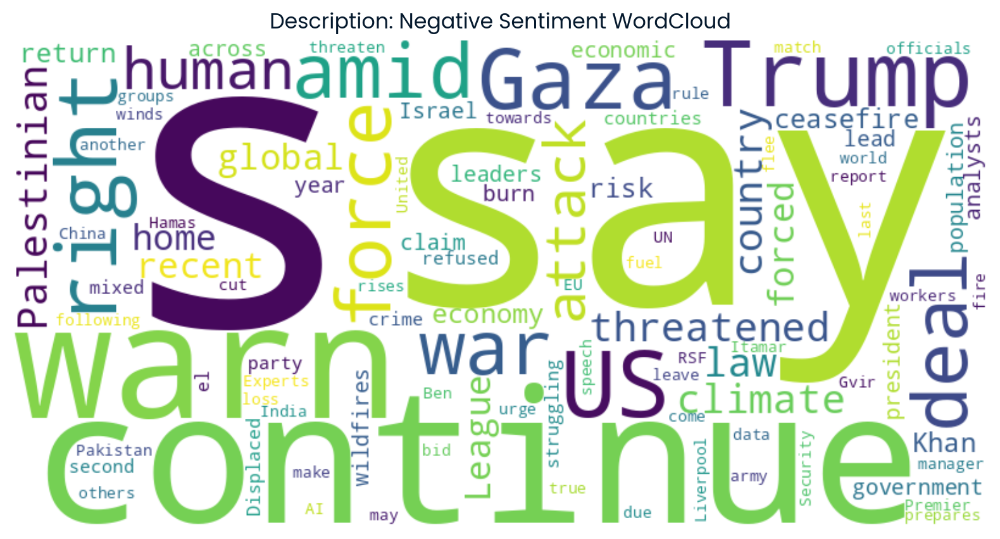

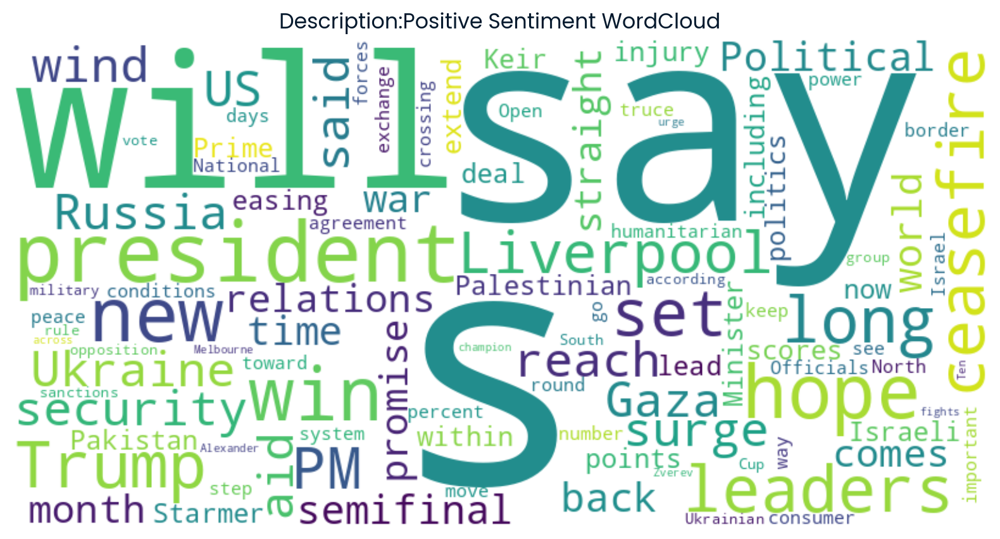

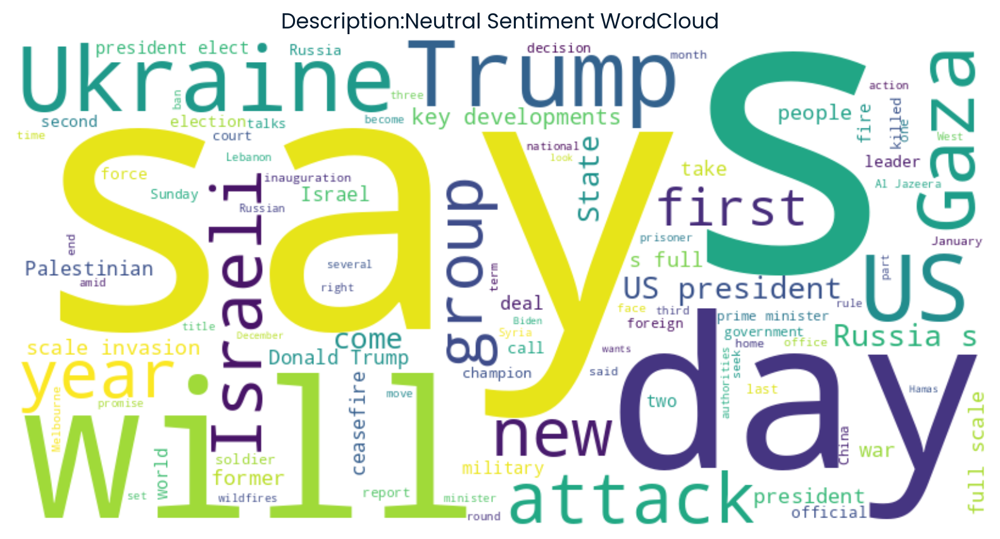

In [18]:

negative_df = df_loaded[df_loaded['sentiment_label'] == 'negative']
positive_df = df_loaded[df_loaded['sentiment_label'] == 'positive']
neutral_df = df_loaded[df_loaded['sentiment_label'] == 'neutral']

# WordClouds for each sentiment category - Descritpion
generate_wordcloud(negative_df, 'Description: Negative Sentiment WordCloud')
generate_wordcloud(positive_df, 'Description:Positive Sentiment WordCloud')
generate_wordcloud(neutral_df, 'Description:Neutral Sentiment WordCloud')


##### Splitting the PubDate column further to Hour, Days, Months, Year  etc


In [19]:
from ipywidgets import interact, IntSlider, Dropdown
import plotly.express as px

def create_interactive_category_analysis(min_count=0, sort_order='Descending'):
    # Prepare data with proper sorting
    category_counts = df_loaded['category'].value_counts().reset_index()
    category_counts.columns = ['category', 'count']
    
    # Apply filters and sorting
    filtered = category_counts[category_counts['count'] >= min_count]
    filtered = filtered.sort_values(
        'count', 
        ascending=(sort_order == 'Ascending')
    )
    
    # Create interactive bar chart
    fig = px.bar(
        filtered,
        y='category',
        x='count',
        orientation='h',
        color_discrete_sequence=['#db8a8c'],
        text='count',
        title='<b>Interactive Category Analysis</b>',
        labels={'count': 'Number of Articles', 'category': ''}
    )
    
    # Add professional styling
    fig.update_layout(
        height=600 + 20 * len(filtered),  # Dynamic height
        width=1000,
        margin=dict(t=80, b=20, l=20, r=20),
        xaxis=dict(visible=False),
        yaxis=dict(
            title='',
            tickfont=dict(family='Araboto Bold 400.ttf', size=12),
            categoryorder='total ascending' if sort_order == 'Ascending' else 'total descending'
        ),
        plot_bgcolor='rgba(0,0,0,0)',
        paper_bgcolor='rgba(0,0,0,0.02)',
        title=dict(
            x=0.5,
            font=dict(size=24, family='Araboto Bold 400.ttf', color='#2c3e50')
        ),
        hoverlabel=dict(
            bgcolor="white",
            font_size=14,
            font_family="Araboto Bold 400.ttf"
        )
    )
    
    # Add custom data labels
    fig.update_traces(
        texttemplate='%{text}',
        textposition='outside',
        textfont=dict(color='#2c3e50', size=12),
        hovertemplate="<b>%{y}</b><br>Articles: %{x}",
        marker=dict(line=dict(width=0.5, color='white'))
    )
    
    # Add scroll zoom functionality
    fig.update_layout(
        dragmode='pan',
        yaxis=dict(fixedrange=True),
        xaxis=dict(fixedrange=True)
    )
    
    fig.show()

# Create interactive controls
interact(create_interactive_category_analysis,
         min_count=IntSlider(
             value=0,
             min=0,
             max=df_loaded['category'].value_counts().max(),
             step=1,
             description='Minimum Count:'
         ),
         sort_order=Dropdown(
             options=['Descending', 'Ascending'],
             value='Descending',
             description='Sort Order:'
         ))

interactive(children=(IntSlider(value=0, description='Minimum Count:', max=354), Dropdown(description='Sort Or…

<function __main__.create_interactive_category_analysis(min_count=0, sort_order='Descending')>

In [20]:
# Import required libraries
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from ipywidgets import interact, Dropdown, fixed
from plotly.subplots import make_subplots

# Date parsing and feature extraction
# Convert pubDate column to datetime type
df_loaded['pubDate'] = pd.to_datetime(df_loaded['pubDate'], format='%d %b %Y', errors='coerce')

# Check for parsing errors
failed_parses = df_loaded['pubDate'].isna().sum()
print(f"Number of dates that couldn't be parsed: {failed_parses}")

# Inspect rows with failed date parsing if any
if failed_parses > 0:
    print("\nRows with unparsable dates:")
    print(df_loaded[df_loaded['pubDate'].isna()])

# Extract date components
df_loaded['Date'] = df_loaded['pubDate'].dt.date
df_loaded['Day'] = df_loaded['pubDate'].dt.day
df_loaded['Month'] = df_loaded['pubDate'].dt.month
df_loaded['Year'] = df_loaded['pubDate'].dt.year
df_loaded['Day of the week'] = df_loaded['pubDate'].dt.strftime('%A')
df_loaded['Hour'] = df_loaded['pubDate'].dt.hour  # Will be 0 since no time info

# Verify extracted columns
print("\nFirst 5 rows with date components:")
print(df_loaded[['pubDate', 'Date', 'Day', 'Month', 'Year', 'Day of the week', 'Hour']].head())

# Interactive time analysis function
def interactive_time_analysis(df, time_unit='Day'):
    # Data validation
    if 'pubDate' not in df.columns or 'sentiment_label' not in df.columns:
        print("Missing required columns: 'pubDate' or 'sentiment_label'")
        return
    
    # Create working copy and ensure datetime
    df = df.copy()
    df['pubDate'] = pd.to_datetime(df['pubDate'])
    
    # Time unit mapping
    time_unit_map = {
        'Hour': ('%H:00', 'hour'),
        'Day': ('%Y-%m-%d', 'date'),
        'Day of Week': ('%A', 'dayofweek'),
        'Month': ('%B', 'month')
    }
    
    # Validate time unit
    if time_unit not in time_unit_map:
        print(f"Invalid time unit: {time_unit}")
        return
    
    # Create time unit column
    fmt, attr = time_unit_map[time_unit]
    if time_unit == 'Day':
        df[time_unit] = df['pubDate'].dt.strftime(fmt)
    else:
        df[time_unit] = df['pubDate'].dt.__getattribute__(attr)
        if time_unit == 'Day of Week':
            df[time_unit] = df[time_unit].map({
                0: 'Monday', 1: 'Tuesday', 2: 'Wednesday',
                3: 'Thursday', 4: 'Friday', 5: 'Saturday', 6: 'Sunday'
            })
    
    # Create figure with dual axes
    fig = make_subplots(specs=[[{"secondary_y": True}]])
    
    # Publication count bar chart
    time_counts = df[time_unit].value_counts().sort_index()
    fig.add_trace(
        go.Bar(
            x=time_counts.index,
            y=time_counts.values,
            name='Publications',
            marker_color='#db8a8c',
            opacity=0.7,
            hovertemplate="<b>%{x}</b><br>Publications: %{y}<extra></extra>"
        ),
        secondary_y=False
    )
    
    # Sentiment line chart
    if time_unit in df.columns:
        sentiment_counts = df.groupby([time_unit, 'sentiment_label']).size().unstack(fill_value=0)
        colors = {'positive': '#5ebd89', 'negative': '#ff8680', 'neutral': '#ebde96'}
        
        for sentiment, color in colors.items():
            if sentiment in sentiment_counts.columns:
                fig.add_trace(
                    go.Scatter(
                        x=sentiment_counts.index,
                        y=sentiment_counts[sentiment],
                        name=f'{sentiment.capitalize()} Sentiment',
                        line=dict(color=color, width=2),
                        mode='lines+markers',
                        hovertemplate="<b>%{x}</b><br>%{y} articles<extra></extra>"
                    ),
                    secondary_y=True
                )
    
    # Configure layout
    fig.update_layout(
        title=f"<b>Publication & Sentiment Trends by {time_unit}</b>",
        xaxis=dict(
            title=time_unit,
            type='category' if time_unit in ['Day of Week', 'Month'] else None,
            tickangle=45
        ),
        yaxis=dict(
            title='Number of Publications',
            showgrid=False
        ),
        yaxis2=dict(
            title='Sentiment Count',
            showgrid=False,
            overlaying='y',
            side='right'
        ),
        hovermode='x unified',
        height=600,
        width=1200,
        plot_bgcolor='rgba(0,0,0,0)',
        paper_bgcolor='rgba(0,0,0,0.02)',
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=1.02,
            xanchor="right",
            x=1
        )
    )
    
    # Date formatting
    if time_unit == 'Day':
        fig.update_xaxes(tickformat="%Y-%m-%d")
    elif time_unit == 'Hour':
        fig.update_xaxes(tickformat="%H:%M")
    
    fig.show()

# Create interactive controls
interact(interactive_time_analysis,
         df=fixed(df_loaded),
         time_unit=Dropdown(
             options=['Hour', 'Day', 'Day of Week', 'Month'],
             value='Day',
             description='Time Unit:'
         ))

Number of dates that couldn't be parsed: 0

First 5 rows with date components:
     pubDate        Date  Day  Month  Year Day of the week  Hour
0 2025-01-21  2025-01-21   21      1  2025         Tuesday     0
1 2025-01-21  2025-01-21   21      1  2025         Tuesday     0
2 2025-01-21  2025-01-21   21      1  2025         Tuesday     0
3 2025-01-21  2025-01-21   21      1  2025         Tuesday     0
4 2025-01-21  2025-01-21   21      1  2025         Tuesday     0


interactive(children=(Dropdown(description='Time Unit:', index=1, options=('Hour', 'Day', 'Day of Week', 'Mont…

<function __main__.interactive_time_analysis(df, time_unit='Day')>

In [21]:
import plotly.express as px
from ipywidgets import interact, IntSlider, FloatSlider, Dropdown

# Add text analysis features
def calculate_text_features(df):
    # Word count
    df['word_count'] = df['description'].apply(lambda x: len(str(x).split()))
    
    # Character count
    df['char_count'] = df['description'].apply(lambda x: len(str(x)))
    
    # Average word length
    df['avg_word'] = df['char_count'] / df['word_count']
    df['avg_word'] = df['avg_word'].round(2)
    
    return df

# Apply to your DataFrame
df_loaded = calculate_text_features(df_loaded)
def interactive_feature_analysis(df, feature='word_count'):
    # Check if feature exists
    if feature not in df.columns:
        print(f"Feature '{feature}' not found in DataFrame")
        return
    
    # Create color mapping
    colors = {'positive': '#5ebd89', 'negative': '#ff8680', 
             'neutral': '#ebde96', 'UNKNOWN': '#cccccc'}
    
    # Create subplots with distribution stats
    fig = px.histogram(df, x=feature, color='sentiment_label', 
                       nbins=30, marginal="box", 
                       color_discrete_map=colors,
                       title=f"Interactive Analysis of {feature.replace('_', ' ').title()}",
                       hover_data=df.columns)
    
    # Add KDE curve
    kde_fig = px.density_contour(df, x=feature, color='sentiment_label',
                                color_discrete_map=colors)
    for trace in kde_fig.data:
        trace.update(showlegend=False)
        fig.add_trace(trace)
    
    # Add dynamic annotations
    fig.update_traces(
        hovertemplate="<b>%{x}</b><br>Count: %{y}",
        selector=dict(type='histogram')
    )
    
    # Add statistical annotations
    stats = df.groupby('sentiment_label')[feature].agg(['mean', 'median', 'std'])
    for i, (sentiment, vals) in enumerate(stats.iterrows()):
        fig.add_annotation(
            x=1.05,
            y=0.9 - i*0.1,
            xref="paper",
            yref="paper",
            text=f"<b>{sentiment}</b><br>μ: {vals['mean']:.1f}<br>σ: {vals['std']:.1f}",
            showarrow=False,
            bgcolor=colors.get(sentiment, '#cccccc'),
            font=dict(color='white')
        )
    
    # Add professional styling
    fig.update_layout(
        height=600,
        width=1000,
        bargap=0.1,
        hovermode='x unified',
        plot_bgcolor='rgba(0,0,0,0)',
        paper_bgcolor='rgba(0,0,0,0.02)',
        legend=dict(
            title='Sentiment',
            orientation="h",
            yanchor="bottom",
            y=1.02,
            xanchor="right",
            x=1
        ),
        xaxis=dict(
            title=feature.replace('_', ' ').title(),
            gridcolor='rgba(0,0,0,0.1)'
        ),
        yaxis=dict(
            title='Count',
            gridcolor='rgba(0,0,0,0.1)'
        )
    )
    
    # Add range slider
    fig.update_layout(
        xaxis=dict(
            rangeslider=dict(
                visible=True,
                thickness=0.05
            )
        )
    )
    
    fig.show()

# Create interactive controls
interact(interactive_feature_analysis,
         df=fixed(df_loaded),
         feature=Dropdown(
             options=['word_count', 'char_count', 'avg_word'],
             value='word_count',
             description='Feature:'
         ))

interactive(children=(Dropdown(description='Feature:', options=('word_count', 'char_count', 'avg_word'), value…

<function __main__.interactive_feature_analysis(df, feature='word_count')>

In [22]:
display(df_loaded[['description','avg_word']].head())
display(df_loaded[['description','char_count']].head())
display(df_loaded[['description', 'word_count']].head())

,description,avg_word
0,"Stewart Rhodes and Enrique Tarrio, who receive...",6.26
1,Donald Trump signs record 26 executive orders ...,6.56
2,British prince and former senior MP Tom Watson...,6.59
3,Herzi Halevi is the most senior Israeli figure...,5.82
4,"For a second time, Donald Trump promises to pu...",5.38


,description,char_count
0,"Stewart Rhodes and Enrique Tarrio, who receive...",119
1,Donald Trump signs record 26 executive orders ...,118
2,British prince and former senior MP Tom Watson...,112
3,Herzi Halevi is the most senior Israeli figure...,99
4,"For a second time, Donald Trump promises to pu...",113


,description,word_count
0,"Stewart Rhodes and Enrique Tarrio, who receive...",19
1,Donald Trump signs record 26 executive orders ...,18
2,British prince and former senior MP Tom Watson...,17
3,Herzi Halevi is the most senior Israeli figure...,17
4,"For a second time, Donald Trump promises to pu...",21


In [ ]:
# pip install nltk
# !python -m nltk.downloader all

In [24]:
# Convert text to lowercase
import nltk
nltk.download('stopwords')
df['description'] = df['description'].apply(lambda x: " ".join(x.lower() for x in x.split()))
# Removal of punctuations
df['description'].str.replace('[^\w\s]','')
#Removal of StopWords
from nltk.corpus import stopwords
stop = stopwords.words('english')
df['description'] = df['description'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))
df['description'].head()

[nltk_data] Downloading package stopwords to /home/repl/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


0    stewart rhodes enrique tarrio, received longes...
1    donald trump signs record 26 executive orders ...
2    british prince former senior mp tom watson sui...
3    herzi halevi senior israeli figure resign octo...
4    second time, donald trump promises pull us glo...
Name: description, dtype: object

In [ ]:
# !rm -rf /root/nltk_data

In [39]:
# import nltk
# nltk.download('all', halt_on_error=False)

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /home/repl/nltk_data...
[nltk_data]    |   Unzipping corpora/abc.zip.
[nltk_data]    | Downloading package alpino to /home/repl/nltk_data...
[nltk_data]    |   Unzipping corpora/alpino.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     /home/repl/nltk_data...
[nltk_data]    |   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_eng to
[nltk_data]    |     /home/repl/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_eng.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     /home/repl/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_ru.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_rus to
[nltk_data]    |     /home/repl/n

True

In [41]:
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /home/repl/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [25]:
try:
    from nltk.corpus import wordnet
    print("WordNet loaded successfully!")
except LookupError:
    print("Manual installation required:")
    !wget https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/packages/corpora/wordnet.zip
    !unzip wordnet.zip -d /root/nltk_data/corpora/
    !rm wordnet.zip

WordNet loaded successfully!


In [38]:
# nltk.data.path.append('/root/nltk_data')
# print("\nCurrent NLTK paths:", nltk.data.path)


Current NLTK paths: ['/kaggle/working/nltk_data', '/root/nltk_data']


In [49]:
import nltk
import os
from nltk.stem import WordNetLemmatizer, PorterStemmer

# 1. DataCamp-specific NLTK configuration
NLTK_DIR = os.path.expanduser('~/nltk_data')

# 2. Ensure directory exists
os.makedirs(NLTK_DIR, exist_ok=True)

# 3. Force-set NLTK data path
nltk.data.path.clear()  # Reset default paths
nltk.data.path.append(NLTK_DIR)

# 4. Robust resource download with verification
REQUIRED_RESOURCES = ['wordnet', 'stopwords', 'omw-1.4']

for resource in REQUIRED_RESOURCES:
    try:
        nltk.data.find(f'corpora/{resource}')
    except LookupError:
        print(f'Downloading {resource}...')
        nltk.download(resource, download_dir=NLTK_DIR)
        nltk.data.path.append(NLTK_DIR)  # Refresh path after download

# 5. Safe processing function with multiple fallbacks
def datacamp_stemming(text):
    st = PorterStemmer()
    
    try:
        # Verify WordNet availability
        nltk.data.find('corpora/wordnet')
        wnl = WordNetLemmatizer()
        
        def process_word(word):
            try:
                return st.stem(wnl.lemmatize(word))
            except:
                return st.stem(word)
                
    except LookupError:
        print('WordNet unavailable, using pure stemming')
        process_word = st.stem

    return ' '.join(process_word(word) for word in text.split())

# 6. Apply with progress
from tqdm.auto import tqdm
tqdm.pandas()

df_loaded['stemmed_description'] = df_loaded['description'].progress_apply(datacamp_stemming)

[nltk_data] Downloading package wordnet to /home/repl/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/repl/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


  0%|          | 0/439 [00:00<?, ?it/s]

WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavailable, using pure stemming
WordNet unavaila

Text Cleaning:   0%|          | 0/439 [00:00<?, ?it/s]

Text Cleaning:   0%|          | 0/439 [00:00<?, ?it/s]

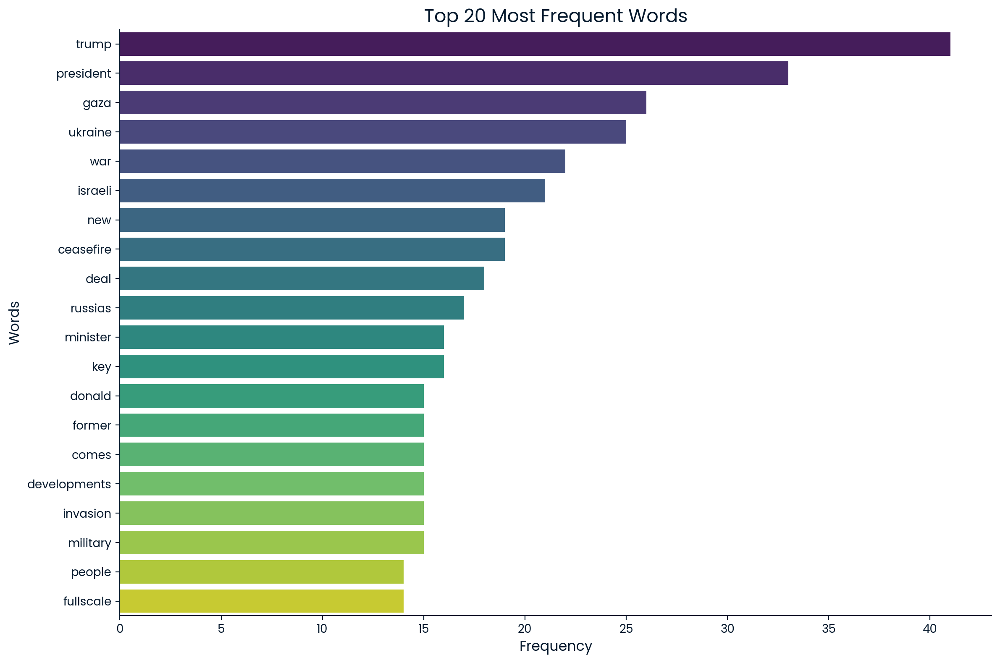

Text Cleaning:   0%|          | 0/439 [00:00<?, ?it/s]

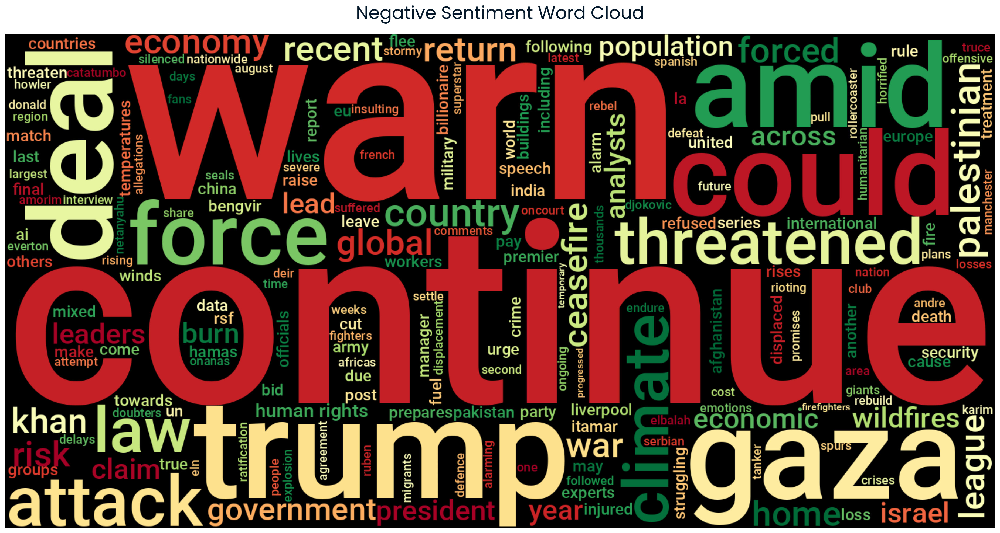

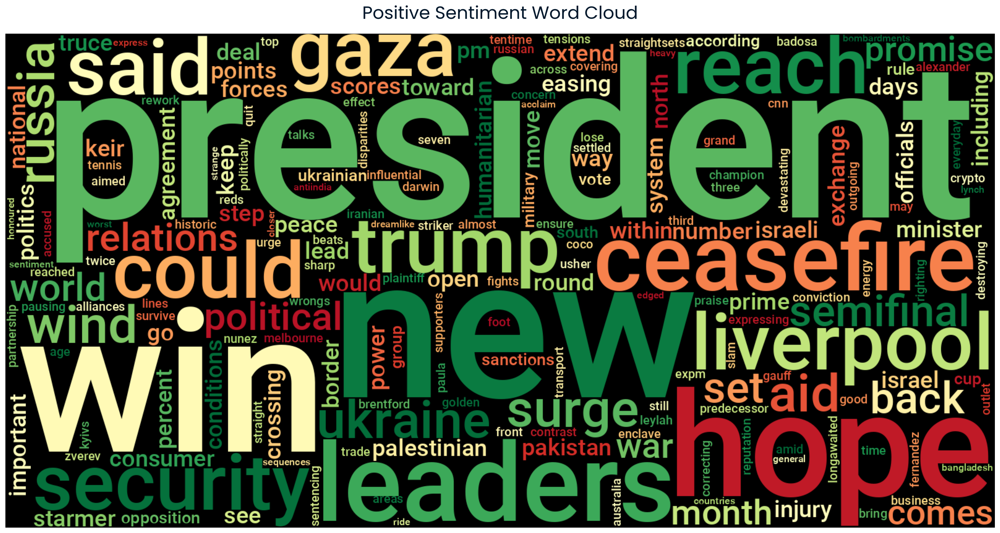

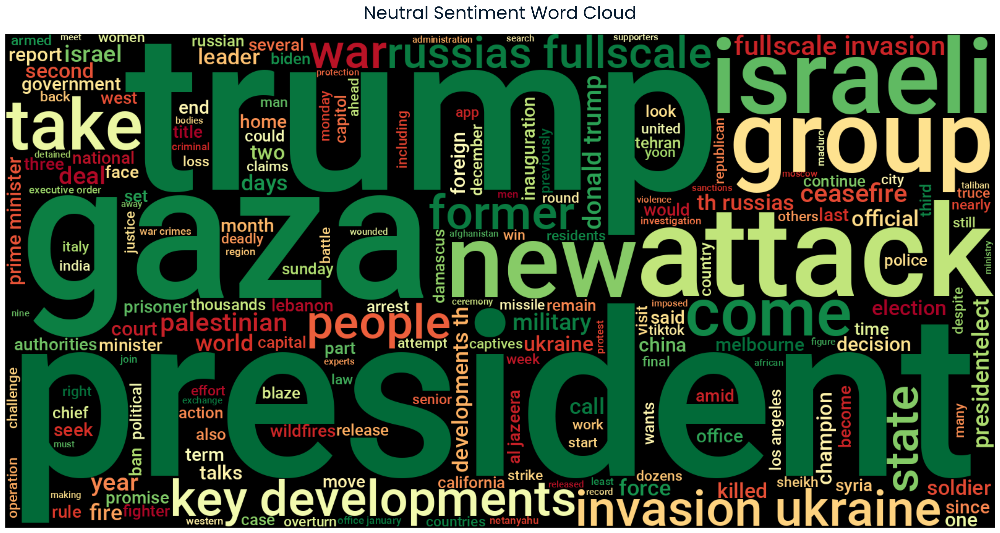

In [50]:
import matplotlib.pyplot as plt
import seaborn as sns
from nltk.stem import PorterStemmer
from wordcloud import WordCloud
from collections import Counter

# Enhanced Text Preprocessing
def enhanced_text_processing(df):
    # Convert to lowercase
    df['description'] = df['description'].str.lower()
    
    # Remove punctuation using regex
    df['description'] = df['description'].str.replace(r'[^\w\s]', '', regex=True)
    
    # Remove stopwords with progress tracking
    stop = set(stopwords.words('english'))
    df['description'] = df['description'].progress_apply(
        lambda x: ' '.join([word for word in x.split() if word not in stop])
    )
    
    # Remove custom frequent words
    custom_stopwords = {"says", 'first', 'us', 'say', 's', 'first', 'day'}
    df['description'] = df['description'].progress_apply(
        lambda x: ' '.join([word for word in x.split() if word not in custom_stopwords])
    )
    
    return df

# Apply preprocessing with progress bar
tqdm.pandas(desc="Text Cleaning")
df_loaded = enhanced_text_processing(df_loaded)

# Enhanced Frequency Analysis
def plot_enhanced_frequency(df, n=20):
    all_words = ' '.join(df['description']).split()
    freq = Counter(all_words)
    
    plt.figure(figsize=(12, 8))
    sns.barplot(x=[v for k,v in freq.most_common(n)], 
                y=[k for k,v in freq.most_common(n)],
                palette="viridis")
    
    plt.title(f'Top {n} Most Frequent Words', fontsize=16)
    plt.xlabel('Frequency', fontsize=12)
    plt.ylabel('Words', fontsize=12)
    sns.despine()
    plt.tight_layout()
    plt.show()

plot_enhanced_frequency(df_loaded)

# Advanced Stemming with Lemmatization Fallback
def advanced_stemming(text):
    st = PorterStemmer()
    wnl = WordNetLemmatizer()
    return ' '.join([
        st.stem(wnl.lemmatize(word))  # Combine lemmatization and stemming
        for word in text.split()
    ])

df_loaded['stemmed_description'] = df_loaded['description'].progress_apply(advanced_stemming)

# Enhanced WordCloud Generation
def generate_enhanced_wordcloud(data, title):
    text = ' '.join(data['description'])
    
    wc = WordCloud(width=1600, height=800,
                   background_color='black',
                   colormap='RdYlGn',
                   font_path="Araboto Medium 400.ttf",
                   stopwords=set(stopwords.words('english'))).generate(text)
    
    plt.figure(figsize=(20, 10))
    plt.imshow(wc, interpolation='bilinear')
    plt.title(title, fontsize=24, pad=20)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# Generate sentiment-specific word clouds
sentiment_groups = {
    'Negative': df_loaded[df_loaded['sentiment_label'] == 'negative'],
    'Positive': df_loaded[df_loaded['sentiment_label'] == 'positive'],
    'Neutral': df_loaded[df_loaded['sentiment_label'] == 'neutral']
}

for sentiment, df_group in sentiment_groups.items():
    generate_enhanced_wordcloud(df_group, f'{sentiment} Sentiment Word Cloud')

In [ ]:
# pip install tqdm
# pip install tqdm pandas
# pip install nltk

In [51]:
from nltk.tokenize import word_tokenize
from nltk import download
from tqdm import tqdm

# Ensure required NLTK resources are downloaded
try:
    download('punkt', quiet=True)
except Exception as e:
    print(f"Error downloading NLTK resources: {e}")
    raise

def tokenize_text(text):
    """
    Enhanced text tokenization with error handling and preprocessing
    
    Args:
        text (str): The text to tokenize
        
    Returns:
        list: A list of cleaned word tokens
    """
    try:
        if not isinstance(text, str) or len(text.strip()) == 0:
            return []
            
        # Preprocessing steps
        text = text.lower().strip()
        
        # Tokenize with NLTK's word tokenizer
        tokens = word_tokenize(text)
        
        # Remove punctuation and empty strings
        tokens = [token for token in tokens if token.isalnum()]
        
        return tokens
        
    except Exception as e:
        print(f"Error tokenizing text: {str(e)[:100]}...")
        return []

# Apply tokenization with progress tracking
tqdm.pandas(desc="Tokenizing Titles")
df_loaded['title_tokens'] = df_loaded['title'].progress_apply(tokenize_text)

tqdm.pandas(desc="Tokenizing Descriptions")
df_loaded['description_tokens'] = df_loaded['description'].progress_apply(tokenize_text)

# Enhanced verification display
print("\nTokenization Verification:")
print("Title Samples:")
display(df_loaded[['title', 'title_tokens']].head(3).style.set_properties(**{
    'title': {'width': '400px', 'white-space': 'pre-wrap'},
    'title_tokens': {'width': '300px', 'white-space': 'pre-wrap'}
}))

print("\nDescription Samples:")
display(df_loaded[['description', 'description_tokens']].head(3).style.set_properties(**{
    'description': {'width': '500px', 'white-space': 'pre-wrap'},
    'description_tokens': {'width': '400px', 'white-space': 'pre-wrap'}
}))

Tokenizing Descriptions: 100%|██████████| 439/439 [00:00<00:00, 9530.14it/s]


Tokenization Verification:
Title Samples:


,title,title_tokens
0,"Far-right Oath Keepers, ex-Proud Boys leaders released after Trump pardons","['oath', 'keepers', 'boys', 'leaders', 'released', 'after', 'trump', 'pardons']"
1,"First raft of lawsuits target US birthright citizenship, other Trump orders","['first', 'raft', 'of', 'lawsuits', 'target', 'us', 'birthright', 'citizenship', 'other', 'trump', 'orders']"
2,Prince Harry court battle against Murdoch UK newspapers delayed,"['prince', 'harry', 'court', 'battle', 'against', 'murdoch', 'uk', 'newspapers', 'delayed']"



Description Samples:


,description,description_tokens
0,stewart rhodes enrique tarrio received longest sentences capitol attack freed prison,"['stewart', 'rhodes', 'enrique', 'tarrio', 'received', 'longest', 'sentences', 'capitol', 'attack', 'freed', 'prison']"
1,donald trump signs record executive orders second terms including effort restrict citizenship,"['donald', 'trump', 'signs', 'record', 'executive', 'orders', 'second', 'terms', 'including', 'effort', 'restrict', 'citizenship']"
2,british prince former senior mp tom watson suing news group newspapers alleged unlawful activities,"['british', 'prince', 'former', 'senior', 'mp', 'tom', 'watson', 'suing', 'news', 'group', 'newspapers', 'alleged', 'unlawful', 'activities']"


In [ ]:
# pip install lemmatizer
# !pip install nltk plotly wordcloud --quiet


In [54]:
import string
import nltk
import os
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords

# DataCamp-compatible NLTK configuration
nltk_data_path = os.path.expanduser('~/nltk_data/')  # Use home directory
os.makedirs(nltk_data_path, exist_ok=True)  # Create directory if needed
nltk.data.path.append(nltk_data_path)  # Add to NLTK's search path

# Download required resources with proper permissions
try:
    nltk.download(['punkt', 'stopwords', 'wordnet'], 
                 download_dir=nltk_data_path,
                 quiet=True)
except PermissionError:
    print(f"Using existing NLTK data in {nltk_data_path}")

# Reinitialize after downloads
try:
    lemmatizer = WordNetLemmatizer()
    stop_words = set(stopwords.words('english'))
except LookupError:
    nltk.data.path.append(nltk_data_path)
    lemmatizer = WordNetLemmatizer()
    stop_words = set(stopwords.words('english'))

# Rest of your code remains the same...
punctuations = set(string.punctuation).union({'“', '”', '’', '‘', '—', '–'})

custom_stopwords = {
    'says', 'us', 'signs', 'said', 'say', 'like', 'also', 'one', 'new', 'will',
    'get', 'just', 'know', 'make', 'see', 'use', 'take', 'come', 'think', 'want',
    'look', 'go', 'back', 'give', 'work', 'long', 'good', 'right', 'still', 'pm', 
    'la', 'talk', 'two', 'set', 'day'
}
stop_words = stop_words.union(custom_stopwords)

def tokenize_text(text):
    """Enhanced text tokenization with error handling"""
    try:
        if not isinstance(text, str) or len(text.strip()) == 0:
            return []
            
        text = text.lower().strip()
        tokens = nltk.word_tokenize(text)
        return [token for token in tokens if token.isalnum()]
        
    except Exception as e:
        print(f"Error tokenizing text: {str(e)[:100]}...")
        return []

# Apply tokenization
tqdm.pandas(desc="Tokenizing Titles")
df_loaded['title_token_word_list'] = df_loaded['title'].progress_apply(tokenize_text)

tqdm.pandas(desc="Tokenizing Descriptions")
df_loaded['desc_token_word_list'] = df_loaded['description'].progress_apply(tokenize_text)

# Analysis functions
def count_topics(df, column_name):
    """Enhanced topic counting with lemmatization and filtering"""
    all_words = []
    
    for text in tqdm(df[column_name], desc=f'Processing {column_name}'):
        try:
            filtered = [
                lemmatizer.lemmatize(word.lower())
                for word in text
                if (isinstance(word, str) and 
                    word.isalpha() and 
                    word.lower() not in stop_words and 
                    len(word) > 1)
            ]
            all_words.extend(filtered)
        except Exception as e:
            print(f"Error processing text: {str(e)[:100]}...")
    
    counter = Counter(all_words)
    return pd.DataFrame({
        'topic': list(counter.keys()),
        'count': list(counter.values())
    }).sort_values('count', ascending=False)

def plot_bar_chart(df, title, top_n=70):
    """Enhanced interactive bar plot"""
    fig = px.bar(
        df.head(top_n),
        x='count',
        y='topic',
        orientation='h',
        color='count',
        color_continuous_scale='Viridis',
        title=title,
        labels={'count': 'Frequency', 'topic': 'Topic'}
    )
    fig.update_layout(showlegend=False, height=800)
    fig.show()

def plot_pie_chart(df, title, top_n=10):
    """Enhanced interactive pie chart"""
    fig = px.pie(
        df.head(top_n),
        values='count',
        names='topic',
        title=title,
        hole=0.4,
        color_discrete_sequence=px.colors.sequential.Viridis
    )
    fig.update_traces(textposition='inside', textinfo='percent+label')
    fig.update_layout(showlegend=False, height=600)
    fig.show()

# Main execution
if 'title_token_word_list' in df_loaded.columns and 'desc_token_word_list' in df_loaded.columns:
    title_topics = count_topics(df_loaded, 'title_token_word_list')
    desc_topics = count_topics(df_loaded, 'desc_token_word_list')
    
    plot_bar_chart(title_topics, 'Top 70 Topics in News Titles')
    plot_pie_chart(title_topics, 'Top 10 Title Topics Distribution')
    
    plot_bar_chart(desc_topics, 'Top 70 Topics in News Descriptions')
    plot_pie_chart(desc_topics, 'Top 10 Description Topics Distribution')
else:
    print("Error: Token columns missing. Verify tokenization steps.")

Processing desc_token_word_list: 100%|██████████| 439/439 [00:00<00:00, 20677.37it/s]


In [55]:
# Convert pubDate to datetime
df_loaded['date'] = pd.to_datetime(df_loaded['pubDate'])

# Weekly sentiment trends
weekly_sentiment = df_loaded.resample('W-Mon', on='date')['sentiment_label'] \
                         .value_counts(normalize=True).unstack()

# Interactive plot
fig = px.line(weekly_sentiment, 
              title='Weekly Sentiment Trends',
              labels={'value':'Percentage', 'date':''})
fig.show()